# Predicting Required Amount of Core-Hours for QuakeCoRE Compute Job

In [71]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np


In [39]:
%matplotlib inline

In [40]:
sns.set()

# Loading the Data and Initial Exploration


In [41]:
train_X = pd.read_csv('../data/emod3d_train_x.csv')

In [42]:
train_X

,nt,nx,ny,nz,n_sub,n_cores
0,8705.0,904.0,1310.0,245.0,99424,200.0
1,2537.0,299.0,195.0,110.0,18360,160.0
2,3779.0,313.0,531.0,112.0,48804,160.0
3,4787.0,414.0,604.0,120.0,77000,160.0
4,2766.0,339.0,352.0,105.0,18135,160.0
...,...,...,...,...,...,...
11829,12053.0,942.0,1761.0,178.0,684200,320.0
11830,6140.0,784.0,939.0,125.0,118272,160.0
11831,2849.0,233.0,258.0,100.0,25272,160.0
11832,6367.0,743.0,927.0,125.0,109983,160.0


In [43]:
train_y = pd.read_csv('../data/emod3d_train_y.csv')

In [44]:
train_y

,core_hours
0,82.000000
1,2.577778
2,4.755556
3,8.711111
4,2.533333
...,...
11829,258.311111
11830,22.711111
11831,2.088889
11832,21.155556


In [45]:
train = pd.concat([train_X, train_y], axis=1)

In [46]:
train

,nt,nx,ny,nz,n_sub,n_cores,core_hours
0,8705.0,904.0,1310.0,245.0,99424,200.0,82.000000
1,2537.0,299.0,195.0,110.0,18360,160.0,2.577778
2,3779.0,313.0,531.0,112.0,48804,160.0,4.755556
3,4787.0,414.0,604.0,120.0,77000,160.0,8.711111
4,2766.0,339.0,352.0,105.0,18135,160.0,2.533333
...,...,...,...,...,...,...,...
11829,12053.0,942.0,1761.0,178.0,684200,320.0,258.311111
11830,6140.0,784.0,939.0,125.0,118272,160.0,22.711111
11831,2849.0,233.0,258.0,100.0,25272,160.0,2.088889
11832,6367.0,743.0,927.0,125.0,109983,160.0,21.155556


In [47]:
train_samp = train.sample(frac=0.05)
train_samp

,nt,nx,ny,nz,n_sub,n_cores,core_hours
1254,8894.0,930.0,1484.0,245.0,81801,200.0,94.944444
897,4106.0,337.0,377.0,118.0,55322,160.0,3.866667
5904,5933.0,776.0,879.0,125.0,108702,160.0,22.133333
7512,3410.0,445.0,435.0,112.0,27636,160.0,4.622222
3579,3321.0,255.0,439.0,100.0,18768,160.0,2.666667
...,...,...,...,...,...,...,...
2835,5386.0,698.0,730.0,118.0,80700,160.0,14.800000
10815,2838.0,216.0,358.0,98.0,21424,160.0,1.822222
1979,5447.0,635.0,785.0,122.0,82716,160.0,14.177778
4519,2116.0,240.0,173.0,92.0,10608,160.0,0.755556


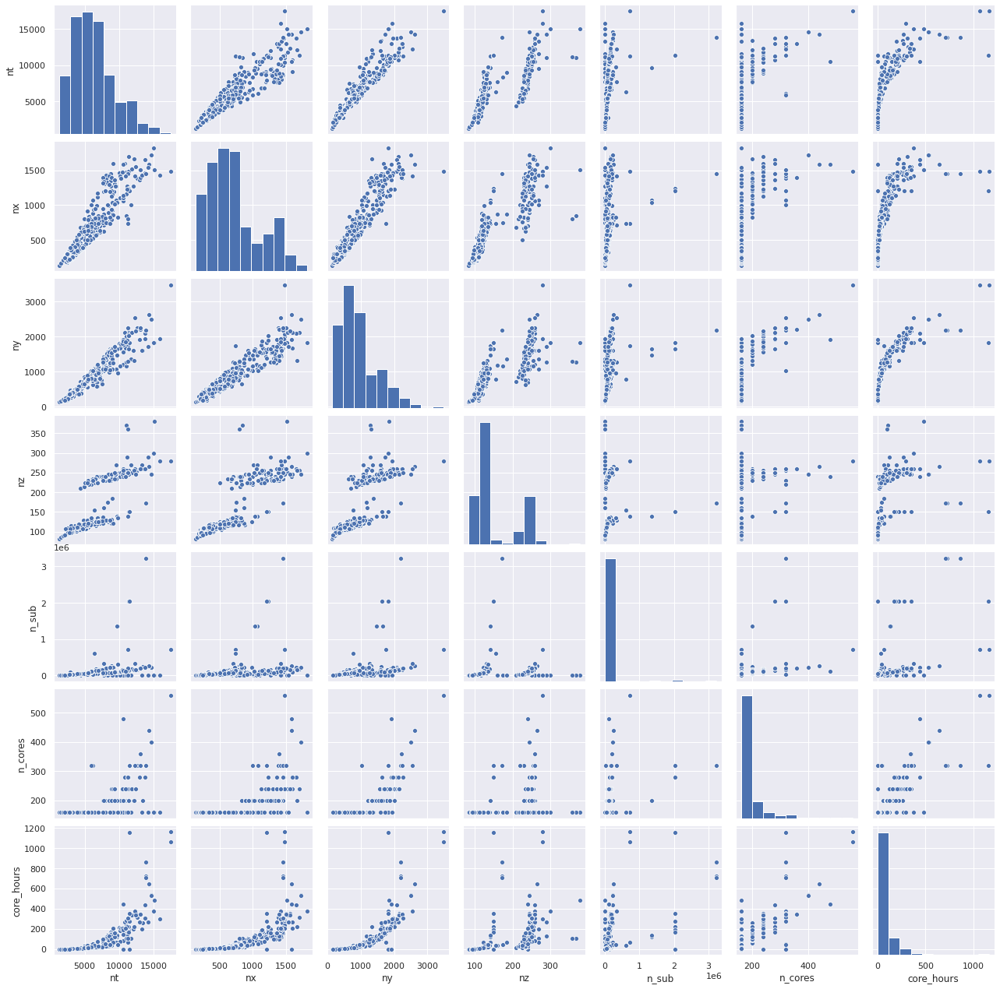

In [48]:
sns.pairplot(train_samp)

## What observations can we make from this data?

- there appears to be a large number of core-hours near 0; better investigate that
- generally around 200 cores were used at a time
- the input `n_sub` is generally always < 0.5 and doesn't appear to be highly correlated with `core_hours`. Its so skewed that it may be worth discarding anything greater, as that might throw off our predictions. The number of dots that lie above `n_sub` > 0.5 eyeballs to be similar to the number of dots that could be considered outliers in the other plots. Perhaps our prediction could by hybrid, using one model when `n_sub` is typically low, and another model when its higher, possibly just fudging in a higher core-hours budget.
- `nx` and `ny`, presumably inputs for some search-space, tend to grow with each other, such that the simulated area tends to be somewhere between a square and rectangle or ratio 1:2 or so.
- `nz` is interesting in that it presumably indicates that studies are done at one of two depths or depth-resolutions... we don't know what `nz` represents

Other thoughts:
- it may be useful to look for core_hours that are very 'round', like for example where the decimal part is .0; that might help identify jobs that reached the budgeted for `core_hours` and were aborted.

# Data Cleaning

## Low end of `core_hours`

It seem that there is a large spike in number of `core_hours` near 0; this may be due to jobs that failed to start. Values that are exactly 0 will not be real jobs, but jobs that do run for a short period of time could still be valid (or might fail for some other reason).

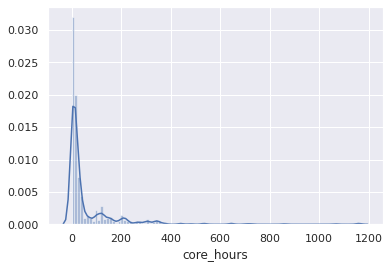

In [49]:
sns.distplot(train_samp['core_hours'], bins=100)

In [50]:
outliers_too_low = train[ train['core_hours'] < 0.2 ]
outliers_too_low

,nt,nx,ny,nz,n_sub,n_cores,core_hours
10,11408.0,1208.0,1831.0,150.0,2035075,320.0,0.0
537,11408.0,1208.0,1831.0,150.0,2035075,320.0,0.0
558,10548.0,1584.0,1923.0,240.0,110740,240.0,0.0
719,11408.0,1208.0,1831.0,150.0,2035075,320.0,0.0
1163,7655.0,1396.0,1318.0,230.0,59055,200.0,0.0
1654,10548.0,1584.0,1923.0,240.0,110740,240.0,0.0
2064,7186.0,1151.0,1213.0,225.0,50960,160.0,0.0
2109,2840.0,324.0,477.0,112.0,106634,320.0,0.0
2124,13830.0,1456.0,2197.0,172.0,3225600,320.0,0.0
2132,11408.0,1208.0,1831.0,150.0,2035075,320.0,0.0


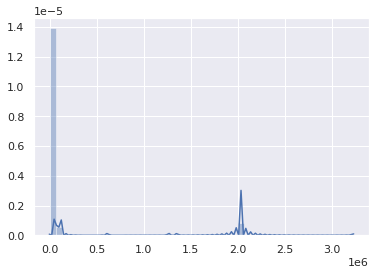

In [51]:
sns.distplot(outliers_too_low)

In [52]:
train.drop(outliers_too_low.index, inplace=True)

In [53]:
train

,nt,nx,ny,nz,n_sub,n_cores,core_hours
0,8705.0,904.0,1310.0,245.0,99424,200.0,82.000000
1,2537.0,299.0,195.0,110.0,18360,160.0,2.577778
2,3779.0,313.0,531.0,112.0,48804,160.0,4.755556
3,4787.0,414.0,604.0,120.0,77000,160.0,8.711111
4,2766.0,339.0,352.0,105.0,18135,160.0,2.533333
...,...,...,...,...,...,...,...
11829,12053.0,942.0,1761.0,178.0,684200,320.0,258.311111
11830,6140.0,784.0,939.0,125.0,118272,160.0,22.711111
11831,2849.0,233.0,258.0,100.0,25272,160.0,2.088889
11832,6367.0,743.0,927.0,125.0,109983,160.0,21.155556


## Identifying `n_sub` in the pairwise plots

`n_sub` is a continuous value, and we would like to identify all those points in the pairwise plots that come from n_sub being high (or low); in case that makes it easy to identify the cause of outliers.

Seaborn's pairplot allows us to give it a `hue` parameter, and you give it the name of a column in the data-frame, and for each value it will break those out as a separate series, but it really needs to a categorical data type. 

That means that we need to (the nomenclature varies) to 'discretize' or 'bin' them.

https://pbpython.com/pandas-qcut-cut.html

In [54]:
train['n_sub_deciles'] = pd.qcut(train['n_sub'], q=10, precision=0)
train_samp['n_sub_deciles'] = pd.qcut(train_samp['n_sub'], q=10, precision=0)

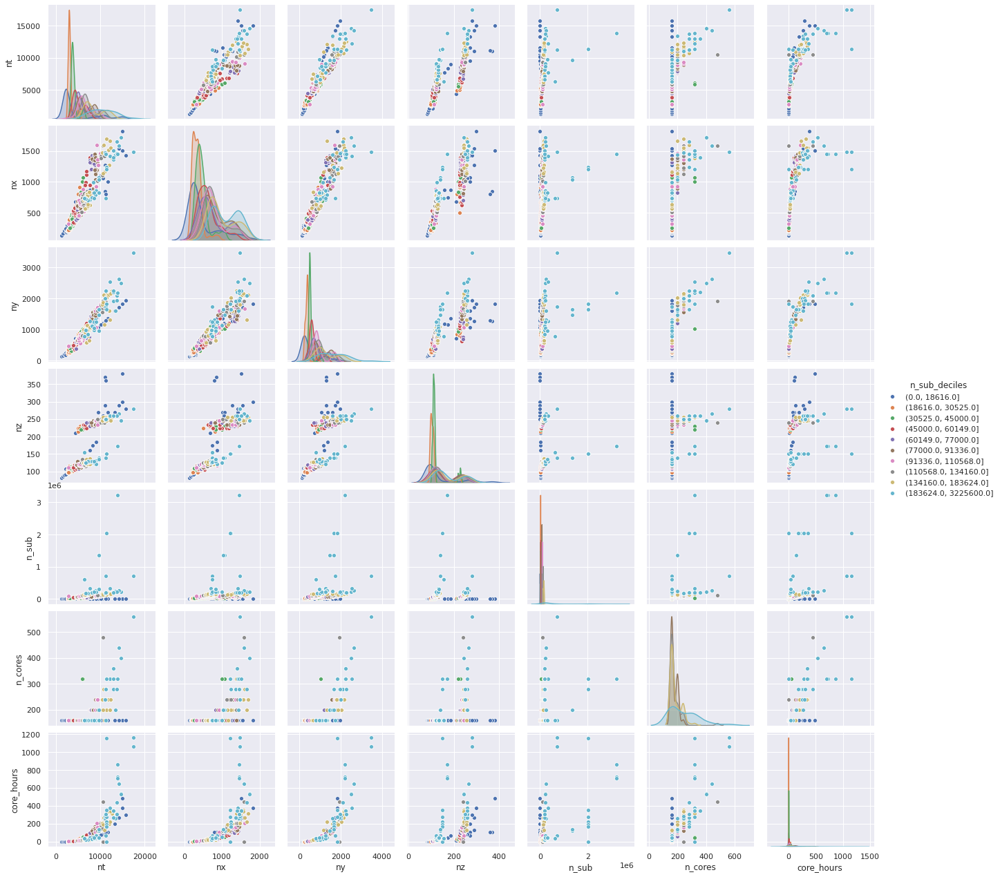

In [55]:
sns.pairplot(train_samp,
    vars=['nt', 'nx', 'ny', 'nz', 'n_sub', 'n_cores', 'core_hours'],
    hue='n_sub_deciles')


## Identifying `n_cores` in the pairplots

Smaller jobs should correlate with fewer cores being requested, which should reflect the user's expectation of how large the job is.

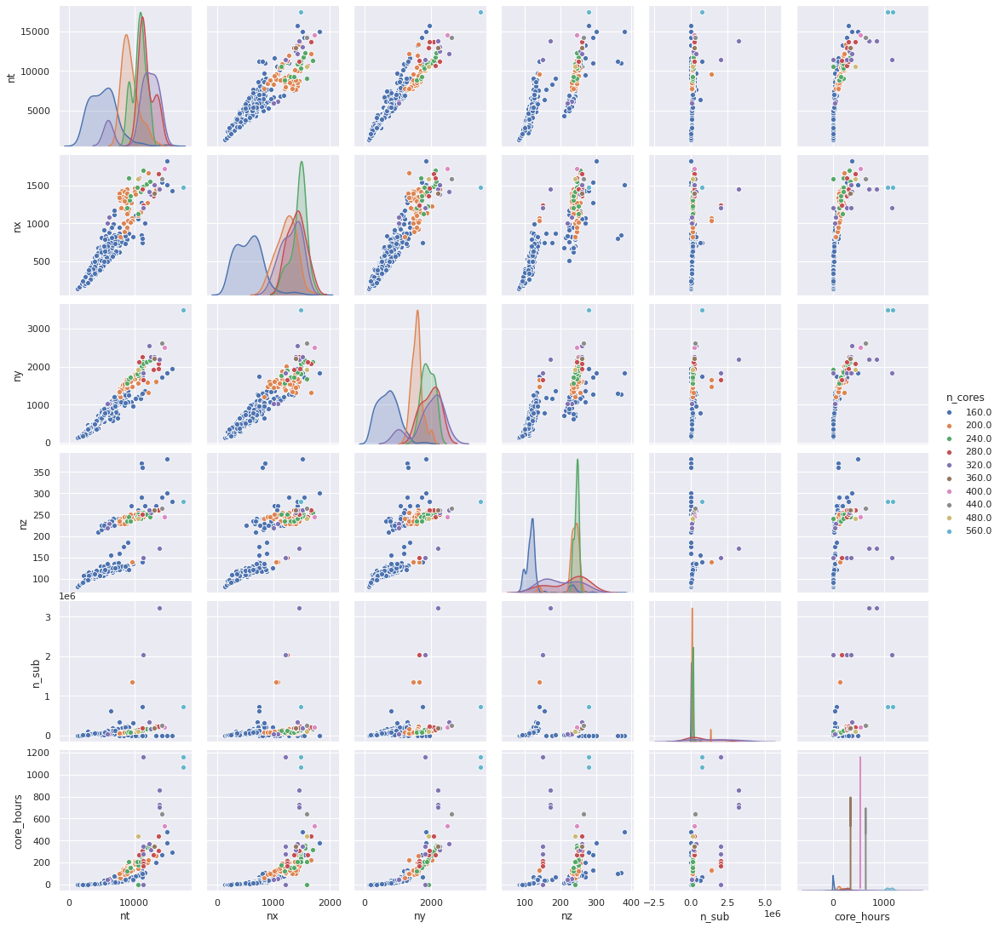

In [56]:
sns.pairplot(train_samp,
    vars=['nt', 'nx', 'ny', 'nz', 'n_sub', 'core_hours'],
    hue='n_cores')

# Should we use a product of nt, nx, ny (and nz) ... ?

The complexity of the simulation would appear to be some product of `nt` (presumably number of time samples), `nx`, `ny` and `nz` (presumably granularity of the 3D simulation). If we use a regression method such as Multiple Regression, then the end up trying to find values for $\alpha$ and the coofficients $\beta_x$ in the following:

$$
\alpha + \beta_1\,nt + \beta_2\,nx + \beta_3\,ny + \beta_4\,nz + \beta_5\,n\_sub + \beta_6\,n\_cores
$$

But if we see an apparent exponential or quadratic type of complexity in time, then it might be better to calculate a new column, such that we get:

$$
ntxyz = nt \times nx \times ny \times nz
$$

$$
\alpha + \beta_1\,ntxyz + \beta_2\,n\_sub + \beta_3\,n\_cores
$$

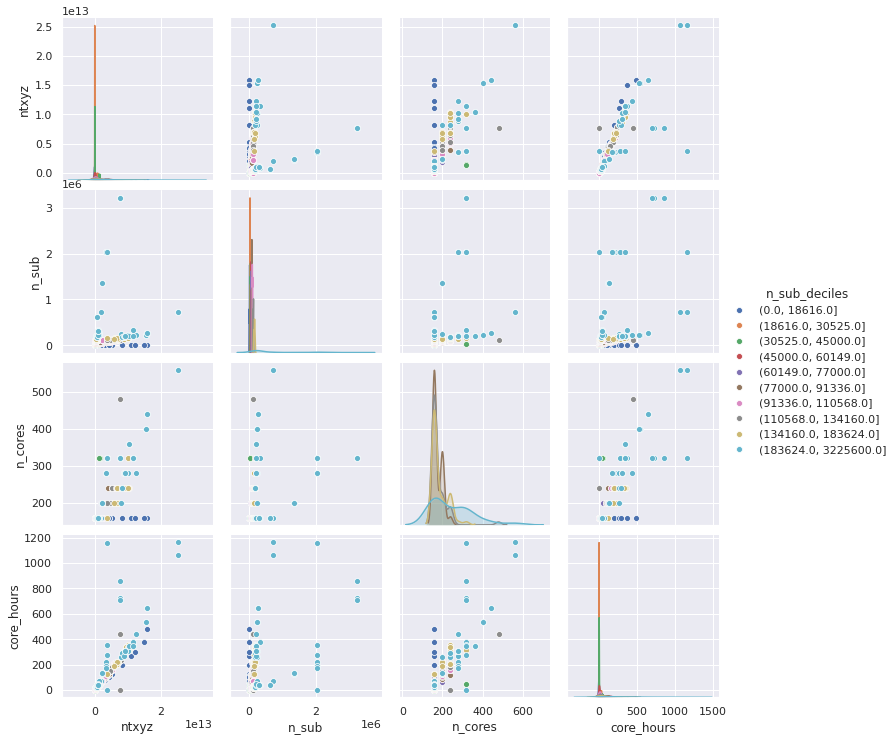

In [57]:
train_samp['ntxyz'] = train_samp['nt'] * train_samp['nx'] * train_samp['ny'] * train_samp['nz']
train['ntxyz'] = train['nt'] * train['nx'] * train['ny'] * train['nz']

sns.pairplot(train_samp, vars=['ntxyz', 'n_sub', 'n_cores', 'core_hours'], hue='n_sub_deciles')

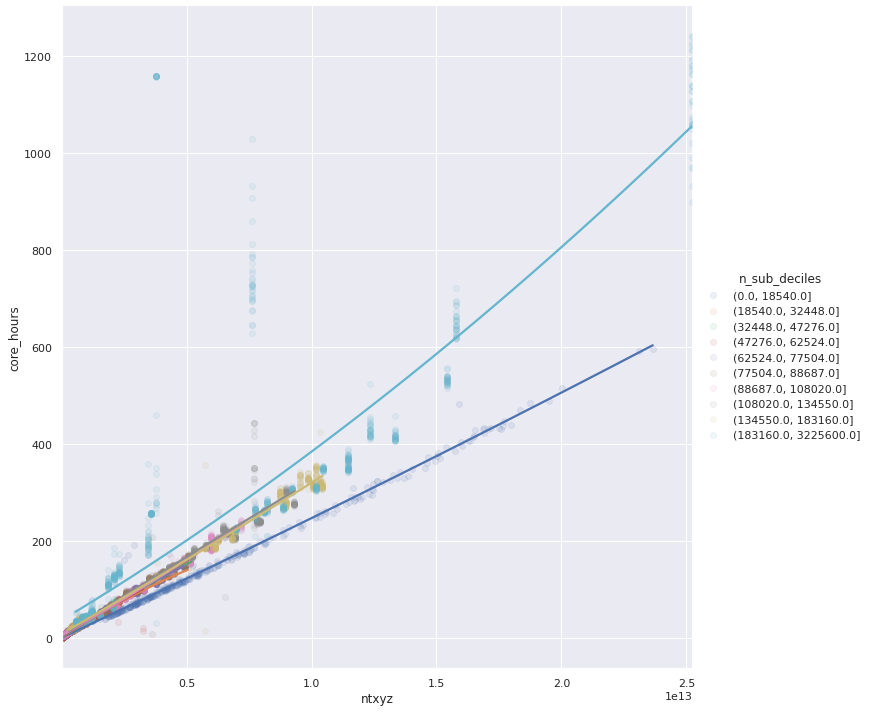

In [131]:
# https://seaborn.pydata.org/tutorial/regression.html

sns.lmplot(
    data=train,
    x='ntxyz',
    y='core_hours',
    hue='n_sub_deciles',
    ci=None,
    height=10,
    scatter_kws={"alpha": .1},
    order=2)

# Ah alpha, the cheaty-statististicians way of expressing localised modality :)

Aha, so that's very interesting. It would appear that `n_sub`, like `n_cores`, reflect the user's expectation of job size and therefore runtime. This job is not 'embarrassingly parallel' in nature; we can see that as `n_sub` increases, overheads such as communication overheads and lock contention work to slow down the system; this presumably doesn't scale well in that final decile, where there is some very erratic performance. However, the final decile for `n_sub` is very very wide compared to the others, which could also mean that, for example, the 90% percentile is okayish, but the 99% is unusable.

Another reason that may explain the erratic behaviour of `n_sub` would be algorithmic changes: its possible that the code might have exhibited exponential complexity but then this was improved to get closer to linear performance. That could explain why there are a few data-points in the first decile that follow the same sort of exponential curve as the last decile. If that were indeed the case, we could drop them; we'd be unlikely to predict performance for an old version of the software.

What _is_ that outlier in the top-left? If I colour the hue using either `n_sub` or `n_cores` I can't make any sence of it, even subdividing the `n_sub` bins over one million, ... that will be easier if I show you instead....


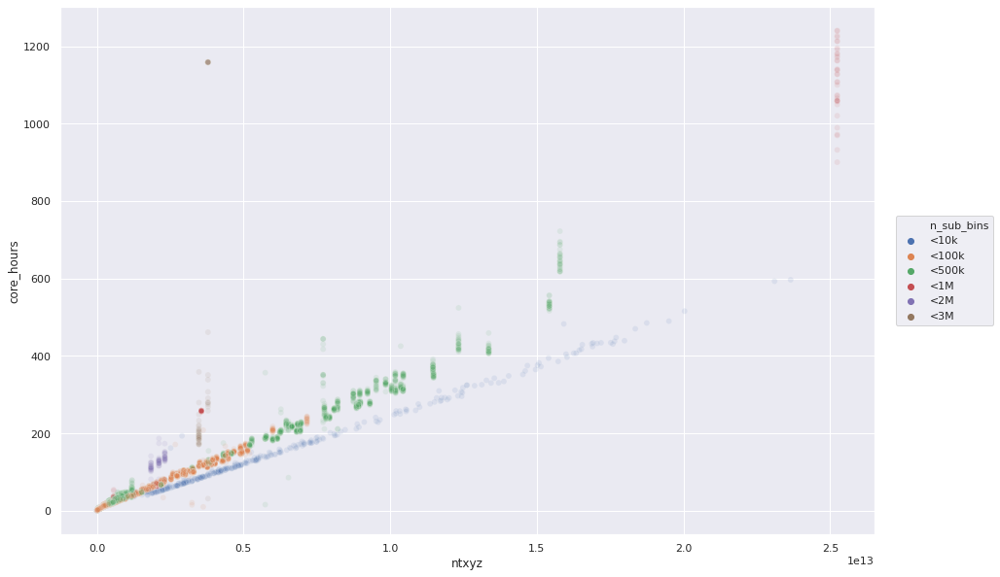

In [130]:
n_sub_bin_cuts=[0, 10_000, 100_000, 500_000, 1_000_000, 2_000_000, 3_000_000]
n_sub_bin_labels=['<10k', '<100k', '<500k', '<1M', '<2M', '<3M']

train['n_sub_bins'] = pd.cut(train['n_sub'], 
    bins=n_sub_bin_cuts, labels=n_sub_bin_labels)

plt.figure(figsize=(15,10))
sns.scatterplot(
    data=train,
    x='ntxyz',
    y='core_hours',
    hue='n_sub_bins',
    hue_order=n_sub_bin_labels,
    alpha=0.1
    ).legend(loc='center left', bbox_to_anchor=(1.02, 0.5), ncol=1)

# https://www.drawingfromdata.com/setting-figure-size-using-seaborn-and-matplotlib

The `core_hours` in the training data is apparently time in CPU, but when the underlying cluster filesystem is busy it can have an impact (which makes me think that this time reported time is really wall-clock hours * num_cores)...

...but then again, it _is_ in a series of `n_sub` the clearly has astronimically bad performance; worse even than the 3-4 million range n_sub... I'm just going to assume that maybe that's an artefact from an older version of the code.

Let's see the raw data that exists around that point...

In [139]:
the_oddity = train[ ( train['core_hours'] > 1000 ) & ( train['n_sub_bins'] == '<3M' ) ][['nt', 'nx', 'ny', 'nz', 'n_sub', 'n_cores', 'core_hours']]
the_oddity

,nt,nx,ny,nz,n_sub,n_cores,core_hours
1316,11408.0,1208.0,1831.0,150.0,2035075,320.0,1157.866667
1717,11408.0,1208.0,1831.0,150.0,2035075,320.0,1158.933333
2142,11408.0,1208.0,1831.0,150.0,2035075,320.0,1159.466667
2168,11408.0,1208.0,1831.0,150.0,2035075,320.0,1158.577778
4341,11408.0,1208.0,1831.0,150.0,2035075,320.0,1158.577778
6769,11408.0,1208.0,1831.0,150.0,2035075,320.0,1158.488889
7353,11408.0,1208.0,1831.0,150.0,2035075,320.0,1158.666667
7970,11408.0,1208.0,1831.0,150.0,2035075,320.0,1158.577778
8579,11408.0,1208.0,1831.0,150.0,2035075,320.0,1159.200000
10826,11408.0,1208.0,1831.0,150.0,2035075,320.0,1158.044444


Interesting, but perhaps not surprising; the same output was arrived at from the same inputs. But is it true (in this case) that the same inputs produce the same outputs? That would be give us some good insight into external factors influencing the results.

In [144]:
train[ ( train['nt'] == 11408.0 ) & ( train['nx'] == 1208.0 ) & ( train['ny'] == 1831.0 ) & ( train['nz'] == 150.0 ) & ( train['n_sub'] == 2035075 ) & ( train['n_cores'] == 320.0 ) ][['nt', 'nx', 'ny', 'nz', 'n_sub', 'n_cores', 'core_hours']]

,nt,nx,ny,nz,n_sub,n_cores,core_hours
98,11408.0,1208.0,1831.0,150.0,2035075,320.0,280.177778
1316,11408.0,1208.0,1831.0,150.0,2035075,320.0,1157.866667
1717,11408.0,1208.0,1831.0,150.0,2035075,320.0,1158.933333
2142,11408.0,1208.0,1831.0,150.0,2035075,320.0,1159.466667
2168,11408.0,1208.0,1831.0,150.0,2035075,320.0,1158.577778
3253,11408.0,1208.0,1831.0,150.0,2035075,320.0,461.155556
4341,11408.0,1208.0,1831.0,150.0,2035075,320.0,1158.577778
4949,11408.0,1208.0,1831.0,150.0,2035075,320.0,278.488889
6769,11408.0,1208.0,1831.0,150.0,2035075,320.0,1158.488889
7353,11408.0,1208.0,1831.0,150.0,2035075,320.0,1158.666667


# Looking at the variance of (nt,nx,ny,nz,n_sub,n_cores) -> core_hours

Here's a bit of an experiment; I'm going to create a fingerprint of each data-point based on rounding each input values, then I'm going to group by that fingerprint, and perform a scatterplot with the dot size being the standard deviation of the group. Might show something interesting.

Similar Unix command-line to create a similar fingerprint data-set; not that I'm going to use it.

    paste -d, emod3d_train_x.csv emod3d_train_y.csv | awk -F, 'NR==1{next} { printf("%d_%d_%d_%d_%d_%d,%f\n", int($1/1000)*1000, int($2/100)*100, int($3/100)*100, int($4/100)*100, int($5/1000)*1000, int($6), $7)}' > emod3d_train_fingerprint.csv

In [155]:
# This part really just shows how to use 'apply' to iterate a function
# over a row.

def fingerprint(row):
    return "{ntr}_{nxr}_{nyr}_{nzr}_{nsr}_{n_cores}".format(
        ntr = int(row['nt'] / 1000) * 1000,
        nxr = int(row['nx'] / 100) * 100,
        nyr = int(row['ny'] / 100) * 100,
        nzr = int(row['nz'] / 100) * 100,
        nsr = int(row['n_sub'] / 1000) * 1000,
        n_cores = int(row['n_cores']))

train['fingerprint'] = train.apply(fingerprint, axis=1)

train[['nt', 'nx', 'ny', 'nz', 'n_sub', 'n_cores', 'fingerprint']].head()

,nt,nx,ny,nz,n_sub,n_cores,fingerprint
0,8705.0,904.0,1310.0,245.0,99424,200.0,8000_900_1300_200_99000_200
1,2537.0,299.0,195.0,110.0,18360,160.0,2000_200_100_100_18000_160
2,3779.0,313.0,531.0,112.0,48804,160.0,3000_300_500_100_48000_160
3,4787.0,414.0,604.0,120.0,77000,160.0,4000_400_600_100_77000_160
4,2766.0,339.0,352.0,105.0,18135,160.0,2000_300_300_100_18000_160


In [266]:
# this is probably a terrible example of using groupby


predictability_df = pd.DataFrame(
    [ [ group['ntxyz'].iat[0],
        group['core_hours'].mean(),
        group['core_hours'].std(),
        name ]
        for name, group in train.groupby('fingerprint') ],
    columns=['ntxyz', 'core_hours', 'core_hours_fingerprint_std', 'fingerprint']).dropna()

predictability_df

,ntxyz,core_hours,core_hours_fingerprint_std,fingerprint
0,3.226884e+12,76.044444,1.677545,10000_1000_1100_200_0_160
1,3.621080e+12,86.703704,2.102446,10000_1000_1200_200_0_160
3,3.703314e+12,84.517460,4.633963,10000_1100_1100_200_0_160
4,3.803483e+12,128.349495,6.499221,10000_1100_1100_200_157000_160
6,4.511469e+12,110.288889,8.478722,10000_1100_1100_300_0_160
...,...,...,...,...
753,2.412098e+12,59.311111,4.054079,9000_800_1000_200_0_160
754,1.196345e+12,58.033716,7.464518,9000_800_1200_100_221000_160
756,1.523954e+12,48.096732,1.182917,9000_800_1400_100_257000_160
760,1.041736e+12,42.714403,2.583281,9000_800_900_100_309000_160


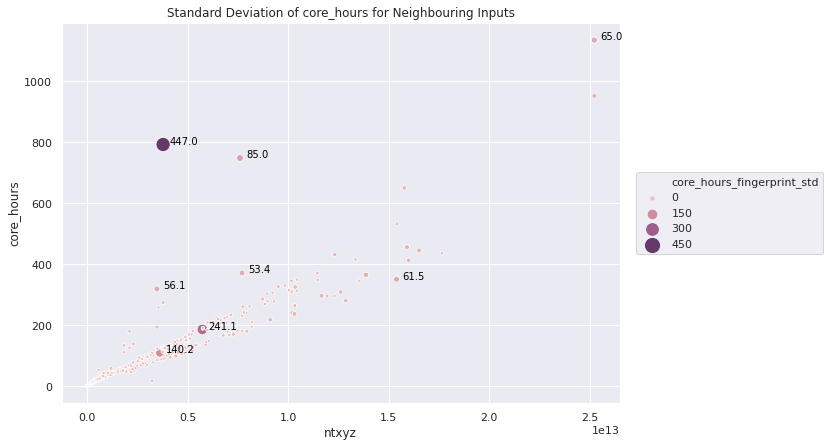

In [267]:
# https://seaborn.pydata.org/generated/seaborn.scatterplot.html

plt.figure(figsize=(10,7))
p = sns.scatterplot(
    data=predictability_df,
    x='ntxyz',
    y='core_hours',
    size='core_hours_fingerprint_std',
    sizes=(10,200),
    hue='core_hours_fingerprint_std',
    palette=sns.cubehelix_palette(dark=.3, light=.8, as_cmap=True))

p.legend(loc='center left', bbox_to_anchor=(1.02, 0.5), ncol=1)

for i in predictability_df[ predictability_df['core_hours_fingerprint_std'] > 50.0 ].index:
    p.text(
        predictability_df['ntxyz'][i] + 0.03e13,
        predictability_df['core_hours'][i],
        "{:.1f}".format(predictability_df['core_hours_fingerprint_std'][i]),
        horizontalalignment='left', size='medium', color='black', weight='normal')
plt.title('Standard Deviation of core_hours for Neighbouring Inputs')
plt.show()

So... something has happened to create some large outliers which cannot be accounted for in the input. Oddly enough, some of these outliers indicate that the program run much faster than normal, as well as some much worse, which might be indicative of system-level issues, or potentially versions of software (not captured in the input) that were faulty.

We could just rip those out; the question would then be at which threshold should we remove those data-points? 65 is not much when you consider we would still be overestimating for our runtime prediction, but 447 would be completely out. 85 seems to be legitimate for the performance curve we have observed. 241 is similarly very significant, particularly when its location on the Y axis is 200; similarly the 140. So I'm confortable in this case making a threshold of 100.

Do do this, we look at the training data and drop all rows with a convicted fingerprint. Hence, its useful to make fingerprints reasonably small so as not to convict other data points which may be innocent, but you still need enough in each fingerprint to have enough of a sample for a useful standard deviation.

In [271]:
train.drop(train[ train.fingerprint.isin( predictability_df[ predictability_df.core_hours_fingerprint_std > 100 ].fingerprint ) ].index, inplace=True)

Now let's see what our data looks like, using the same plot as used previously:

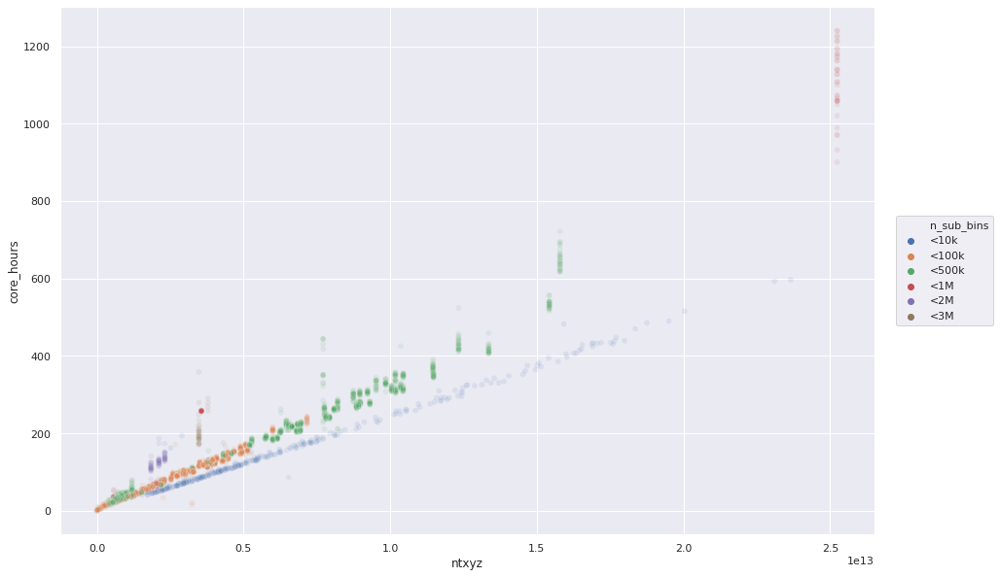

In [272]:
plt.figure(figsize=(15,10))
sns.scatterplot(
    data=train,
    x='ntxyz',
    y='core_hours',
    hue='n_sub_bins',
    hue_order=n_sub_bin_labels,
    alpha=0.1
    ).legend(loc='center left', bbox_to_anchor=(1.02, 0.5), ncol=1)

Great stuff; that's looking much cleaner. The Big Red Dot is still significant, but it may be too disingenuous to remove that.

# Can we expect the same distribution of `n_sub` in the test data?

Seems that we can; the distribution looks to be very very similar; perhaps the test set was a defined using a modulo-N of the total data. This will be bad, because it then very likely include the same system noise that produced the outlier fingerprints.


In [61]:
test_x = pd.read_csv('../data/emod3d_test_x.csv')


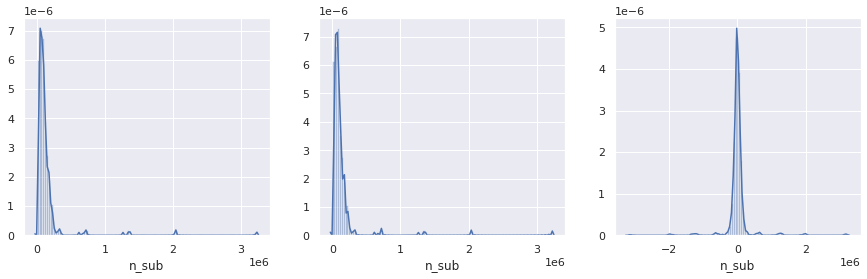

In [76]:
fig, ax = plt.subplots(1,3)
fig.set_figwidth(15)
sns.distplot(test_x['n_sub'], bins=100, ax=ax[0])
sns.distplot(train['n_sub'], bins=100, ax=ax[1])

# See how close they really are; taller the spike at 0: fewer differences
sns.distplot(test_x['n_sub'] - train['n_sub'], bins=100, ax=ax[2])
fig.show()


# Split training data for hybrid model

Given how predictable the program beforms with `n_sub` <10k, we can certainly minimise the loss there, and we've seen that behaves nice and linearly; <500k could be treated much the same as <1M, although a 2nd order polynomial will be our friend there, although we might want to add a safe factor based on `n_sub`.


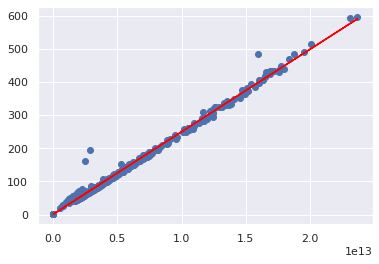

In [284]:
# https://towardsdatascience.com/linear-regression-in-6-lines-of-python-5e1d0cd05b8d

from sklearn.linear_model import LinearRegression

n_sub_bin='<10k'

# Get the data for this n_sub partition
series = train[ train.n_sub_bins == n_sub_bin ]

# https://pandas.pydata.org/docs/user_guide/reshaping.html
X = series.ntxyz.values.reshape(-1, 1)
Y = series.core_hours.values.reshape(-1, 1)

# Fit the model
linear_regressor = LinearRegression()
linear_regressor.fit(X, Y)

# Make predictions to visualise
Y_pred = linear_regressor.predict(X)

# Show the input points with the regressed model
plt.scatter(X, Y)
plt.plot(X, Y_pred, color='red') 
plt.show()

#for n_sub_bin in train.n_sub_bins.unique dropna():



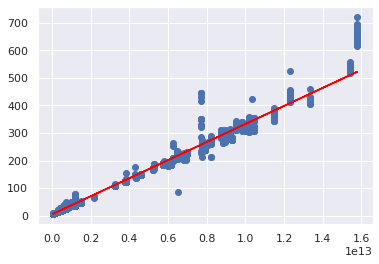

In [285]:
n_sub_bin='<500k'

# Get the data for this n_sub partition
series = train[ train.n_sub_bins == n_sub_bin ]

# https://pandas.pydata.org/docs/user_guide/reshaping.html
X = series.ntxyz.values.reshape(-1, 1)
Y = series.core_hours.values.reshape(-1, 1)

# Fit the model
linear_regressor = LinearRegression()
linear_regressor.fit(X, Y)

# Make predictions to visualise
Y_pred = linear_regressor.predict(X)

# Show the input points with the regressed model
plt.scatter(X, Y)
plt.plot(X, Y_pred, color='red') 
plt.show()

# Now we should have some data ready to normalise

In [65]:
import statsmodels.api as sm
from sklearn.preprocessing import StandardScaler

scale = StandardScaler()

train_X[['nt','nx','ny','nz','n_sub','n_cores']]

# scale.fit_transform(train_X[['nt','nx','ny','nz','n_sub','n_cores']].as_matrix())

,nt,nx,ny,nz,n_sub,n_cores
0,8705.0,904.0,1310.0,245.0,99424,200.0
1,2537.0,299.0,195.0,110.0,18360,160.0
2,3779.0,313.0,531.0,112.0,48804,160.0
3,4787.0,414.0,604.0,120.0,77000,160.0
4,2766.0,339.0,352.0,105.0,18135,160.0
...,...,...,...,...,...,...
11829,12053.0,942.0,1761.0,178.0,684200,320.0
11830,6140.0,784.0,939.0,125.0,118272,160.0
11831,2849.0,233.0,258.0,100.0,25272,160.0
11832,6367.0,743.0,927.0,125.0,109983,160.0
